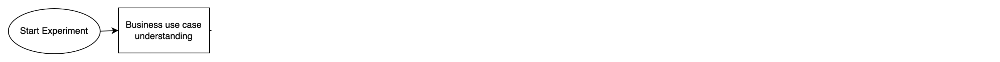

# **Auto insurance fraud detection**

**What is Auto Insurance fraud?**

`This type of fraud entails someone deceiving an insurance company about a claim involving their personal or commercial motor vehicle. It can involve giving out misleading information or providing false documentation to support the claim.`                                                                                                                      ``source: www.michigan.gov``


This Data Science experiment is an approachto establish a ML Model based on Supervised Learning methods to detect if a claim is possibly a `Fraud` submission or not.

From the given dataset, for every CustomerID there is a label given given as 'Y' and 'N' that depicts Yes and No for any customer claim that has been identified as Fraud in the past. 

Thus, this is a typical `Classification` kind of `Supervised Machine Learning` problem. 

In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split
import numpy as np
import sklearn.metrics
from pylab import rcParams
%matplotlib inline
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

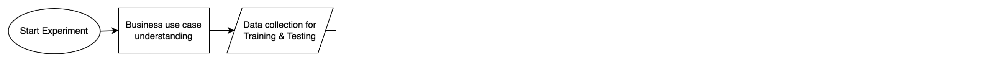

# Data collection for training

In [2]:
df_demo = pd.read_csv('TrainData/Train_Demographics.csv')
df_claim = pd.read_csv('TrainData/Train_Claim.csv')
df_pol = pd.read_csv('TrainData/Train_Policy.csv')
df_veh = pd.read_csv('TrainData/Train_Vehicle.csv')
df_labels = pd.read_csv('TrainData/Traindata_with_Target.csv')

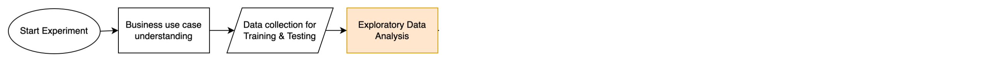

## Exploratory data analysis 

In [3]:
# Printing the shape of each dataframe

for d in [(df_demo.shape),(df_claim.shape),(df_pol.shape),(df_veh.shape),(df_labels.shape)]:
    print(d)

(28836, 10)
(28836, 19)
(28836, 10)
(115344, 3)
(28836, 2)


**`Seems like only vehicles data is not of same shape as compared to others`**

**`Continuing with the data type analysis of all the feature columns`**

In [4]:
# Given dtypes of the feature columns in the data files.

print('\x1b[1;03;30;47m'+'Dtypes for Demographics:\n'+'\x1b[0m' ,df_demo.dtypes)
print('\x1b[1;03;30;46m'+'Dtypes for Policy:\n'+'\x1b[0m' ,df_pol.dtypes)
print('\x1b[1;03;30;41m'+'Dtypes for Claim:\n'+'\x1b[0m' ,df_claim.dtypes)
print('\x1b[1;03;37;40m'+'Dtypes for Vehicles:\n'+'\x1b[0m' ,df_veh.dtypes)
print('\x1b[1;03;30;44m'+'Dtypes for Reported Fraud:\n'+'\x1b[0m' ,df_labels.dtypes)

Dtypes for Demographics:
 CustomerID               object
InsuredAge                int64
InsuredZipCode            int64
InsuredGender            object
InsuredEducationLevel    object
InsuredOccupation        object
InsuredHobbies           object
CapitalGains              int64
CapitalLoss               int64
Country                  object
dtype: object
Dtypes for Policy:
 InsurancePolicyNumber           int64
CustomerLoyaltyPeriod           int64
DateOfPolicyCoverage           object
InsurancePolicyState           object
Policy_CombinedSingleLimit     object
Policy_Deductible               int64
PolicyAnnualPremium           float64
UmbrellaLimit                   int64
InsuredRelationship            object
CustomerID                     object
dtype: object
Dtypes for Claim:
 CustomerID               object
DateOfIncident           object
TypeOfIncident           object
TypeOfCollission         object
SeverityOfIncident       object
AuthoritiesContacted     object
IncidentState  

In [5]:
# Redefining the categorical features to type 'Category'

cat_cols = ['InsuredGender', 'InsuredEducationLevel', 'InsuredOccupation', 'InsuredHobbies']

for col in [cat_cols]:
    df_demo[col] = df_demo[col].astype('category')
    
cat_cols = ['InsurancePolicyState', 'Policy_CombinedSingleLimit', 'InsuredRelationship']

for col in [cat_cols]:
    df_pol[col] = df_pol[col].astype('category')
    
cat_cols = ['TypeOfIncident','TypeOfCollission','SeverityOfIncident','AuthoritiesContacted','IncidentState','IncidentCity','IncidentAddress','NumberOfVehicles','PropertyDamage','BodilyInjuries','Witnesses','PoliceReport']

for col in [cat_cols]:
    df_claim[col] = df_claim[col].astype('category')

cat_cols = ['VehicleAttribute','VehicleAttributeDetails']

for col in [cat_cols]:
    df_veh[col] = df_veh[col].astype('category')
    
df_labels['ReportedFraud'] = df_labels['ReportedFraud'].astype('category')



In [6]:
# Validating dtypes of the feature columns post conversion.

print('\x1b[1;03;30;47m'+'Dtypes for Demographics:\n'+'\x1b[0m' ,df_demo.dtypes)
print('\x1b[1;03;30;46m'+'Dtypes for Policy:\n'+'\x1b[0m' ,df_pol.dtypes)
print('\x1b[1;03;30;41m'+'Dtypes for Claim:\n'+'\x1b[0m' ,df_claim.dtypes)
print('\x1b[1;03;37;40m'+'Dtypes for Vehicles:\n'+'\x1b[0m' ,df_veh.dtypes)
print('\x1b[1;03;30;44m'+'Dtypes for Reported Fraud:\n'+'\x1b[0m' ,df_labels.dtypes)

Dtypes for Demographics:
 CustomerID                 object
InsuredAge                  int64
InsuredZipCode              int64
InsuredGender            category
InsuredEducationLevel    category
InsuredOccupation        category
InsuredHobbies           category
CapitalGains                int64
CapitalLoss                 int64
Country                    object
dtype: object
Dtypes for Policy:
 InsurancePolicyNumber            int64
CustomerLoyaltyPeriod            int64
DateOfPolicyCoverage            object
InsurancePolicyState          category
Policy_CombinedSingleLimit    category
Policy_Deductible                int64
PolicyAnnualPremium            float64
UmbrellaLimit                    int64
InsuredRelationship           category
CustomerID                      object
dtype: object
Dtypes for Claim:
 CustomerID                 object
DateOfIncident             object
TypeOfIncident           category
TypeOfCollission         category
SeverityOfIncident       category
Authori

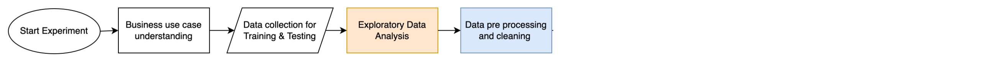

## Data pre processing and cleaning

In [7]:
# Exploring further the Vehicles data set for a customer

df_veh.loc[df_veh['CustomerID'] == 'Cust33335']

,CustomerID,VehicleAttribute,VehicleAttributeDetails
2,Cust33335,VehicleMake,Toyota
8253,Cust33335,VehicleModel,Highlander
45149,Cust33335,VehicleID,Vehicle8998
110725,Cust33335,VehicleYOM,2001


**`As can be inferred from above, it seems for each customer there are four (4) records and hence the total number of rows in the data set is 115344 which is 4 times 28836`**

`So now, it is better to distribute the dataset into 4 different tables.`

In [8]:
# Distributing the vehicle data set to 4 different data sets
df_veh = df_veh.groupby('VehicleAttribute')
df_veh_make = df_veh.get_group('VehicleMake')
df_veh_id = df_veh.get_group('VehicleID')
df_veh_YOM = df_veh.get_group('VehicleYOM')
df_veh_model = df_veh.get_group('VehicleModel')

# Checking the length of each vehicle data set
len(df_veh_make), len(df_veh_id), len(df_veh_model), len(df_veh_YOM)

(28836, 28836, 28836, 28836)

In [9]:
# Dropping the 'VehicleAttribute' column for all the 4 derived tables, since it doesn't contain meaningful info

df_veh_id.drop(['VehicleAttribute'], axis=1, inplace=True)
df_veh_make.drop(['VehicleAttribute'], axis=1, inplace=True)
df_veh_model.drop(['VehicleAttribute'], axis=1, inplace=True)
df_veh_YOM.drop(['VehicleAttribute'], axis=1, inplace=True)

# Renaimg the 'VehicleAttributeDetails' column for all the 4 derived tables to their respective table names to avoid feature column duplicacy.

df_veh_id.rename(columns={'VehicleAttributeDetails':'VehicleID'}, inplace=True)
df_veh_make.rename(columns={'VehicleAttributeDetails':'VehicleMake'}, inplace=True)
df_veh_model.rename(columns={'VehicleAttributeDetails':'VehicleModel'}, inplace=True)
df_veh_YOM.rename(columns={'VehicleAttributeDetails':'VehicleYOM'}, inplace=True)

# Checking the newly derived tables from the vehicles table
print('\x1b[1;03;30;47m'+'Vehicle ID:\n'+'\x1b[0m' , df_veh_id.head())
print('\x1b[1;03;30;45m'+'Vehicle Make:\n'+'\x1b[0m', df_veh_make.head())
print('\x1b[1;03;30;47m'+'Vehicle Model:\n'+'\x1b[0m', df_veh_model.head())
print('\x1b[1;03;30;45m'+'Vehicle YOM:\n'+'\x1b[0m', df_veh_YOM.head())


Vehicle ID:
    CustomerID     VehicleID
0   Cust20179   Vehicle8898
4   Cust13038  Vehicle30212
5    Cust1801  Vehicle24096
10  Cust14947  Vehicle15216
16  Cust19144  Vehicle29018
Vehicle Make:
    CustomerID VehicleMake
2   Cust33335      Toyota
9   Cust20624   Chevrolet
13   Cust9006      Accura
15  Cust18447       Honda
20  Cust17021         BMW
Vehicle Model:
    CustomerID VehicleModel
1   Cust21384       Malibu
3   Cust27118         Neon
6   Cust30237          RAM
27  Cust23684         Neon
33  Cust35737     Wrangler
Vehicle YOM:
    CustomerID VehicleYOM
7   Cust21334       1996
8   Cust26634       1999
11  Cust21432       2002
12  Cust22845       2000
14  Cust30659       2003


/var/folders/t_/lrpykrwd2z51b0hwdttpyf7c0000gn/T/ipykernel_88294/2278491463.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_veh_id.drop(['VehicleAttribute'], axis=1, inplace=True)
/var/folders/t_/lrpykrwd2z51b0hwdttpyf7c0000gn/T/ipykernel_88294/2278491463.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_veh_make.drop(['VehicleAttribute'], axis=1, inplace=True)
/var/folders/t_/lrpykrwd2z51b0hwdttpyf7c0000gn/T/ipykernel_88294/2278491463.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

<AxesSubplot:xlabel='ReportedFraud', ylabel='count'>

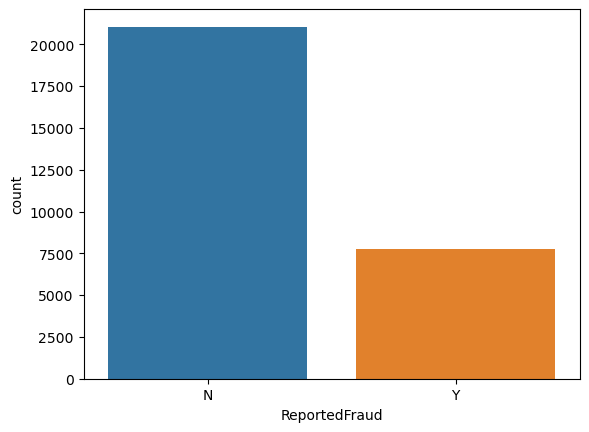

In [10]:
# Checking the distribution of labels for frauds reported.

sns.countplot(x=df_labels['ReportedFraud'])

### Now merging all the data sets (tables) on CustomerID

In [11]:
df1 = pd.merge(df_labels, df_claim, on = ['CustomerID'], how = 'inner')
df2 = pd.merge(df1, df_demo, on = ['CustomerID'], how = 'inner')
df3 = pd.merge(df2, df_pol, on = ['CustomerID'], how = 'inner')
df4 = pd.merge(df3, df_veh_model, on = ['CustomerID'], how = 'inner')
df5 = pd.merge(df4, df_veh_make, on = ['CustomerID'], how = 'inner')
df_train = pd.merge(df5, df_veh_YOM, on = ['CustomerID'], how = 'inner')

df_train.head()

,CustomerID,ReportedFraud,DateOfIncident,TypeOfIncident,TypeOfCollission,SeverityOfIncident,AuthoritiesContacted,IncidentState,IncidentCity,IncidentAddress,IncidentTime,NumberOfVehicles,PropertyDamage,BodilyInjuries,Witnesses,PoliceReport,AmountOfTotalClaim,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredZipCode,InsuredGender,InsuredEducationLevel,InsuredOccupation,InsuredHobbies,CapitalGains,CapitalLoss,Country,InsurancePolicyNumber,CustomerLoyaltyPeriod,DateOfPolicyCoverage,InsurancePolicyState,Policy_CombinedSingleLimit,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit,InsuredRelationship,VehicleModel,VehicleMake,VehicleYOM
0,Cust20065,N,2015-01-09,Multi-vehicle Collision,Rear Collision,Total Loss,Other,State9,City4,Location 1404,19,3,?,1,1,?,43973,9396,4698,29879,58,471784,MALE,JD,sales,video-games,0,-42700,India,129186,432,1998-11-14,State2,250/500,2000,1142.87,0,own-child,E400,Mercedes,2005
1,Cust37589,N,2015-02-20,Single Vehicle Collision,Side Collision,Minor Damage,Ambulance,State4,City3,Location 1675,14,1,?,1,1,YES,62310,6539,6539,49232,34,431937,FEMALE,High School,transport-moving,polo,51300,0,India,146710,128,2000-08-19,State2,100/300,1000,1274.38,2857344,own-child,Highlander,Toyota,2010
2,Cust24312,N,2015-01-14,Multi-vehicle Collision,Side Collision,Major Damage,Ambulance,State5,City2,Location 1546,21,3,?,0,0,?,42824,6069,6069,30686,52,479320,FEMALE,PhD,machine-op-inspct,exercise,0,0,India,133433,346,2000-06-23,State1,500/1000,745,1269.93,0,other-relative,Passat,Volkswagen,2002
3,Cust5493,Y,2015-01-07,Multi-vehicle Collision,Side Collision,Major Damage,Ambulance,State7,City4,Location 1413,12,3,YES,2,0,?,45672,253,5741,39678,25,607763,FEMALE,College,exec-managerial,exercise,47400,-56100,India,114614,42,1992-01-15,State2,100/300,986,1218.60,0,other-relative,Highlander,Toyota,2011
4,Cust7704,Y,2015-02-26,Multi-vehicle Collision,Side Collision,Major Damage,Other,State4,City6,Location 1367,3,3,NO,1,2,NO,81472,7407,14813,59252,27,441783,MALE,Masters,sales,chess,0,0,India,116825,109,2001-09-23,State3,250/500,576,1431.02,4235779,unmarried,Wrangler,Ford,2010


In [12]:
# validating the data types of merged data frame

df_train.dtypes

CustomerID                      object
ReportedFraud                 category
DateOfIncident                  object
TypeOfIncident                category
TypeOfCollission              category
SeverityOfIncident            category
AuthoritiesContacted          category
IncidentState                 category
IncidentCity                  category
IncidentAddress               category
IncidentTime                     int64
NumberOfVehicles              category
PropertyDamage                category
BodilyInjuries                category
Witnesses                     category
PoliceReport                  category
AmountOfTotalClaim              object
AmountOfInjuryClaim              int64
AmountOfPropertyClaim            int64
AmountOfVehicleDamage            int64
InsuredAge                       int64
InsuredZipCode                   int64
InsuredGender                 category
InsuredEducationLevel         category
InsuredOccupation             category
InsuredHobbies           

In [13]:
# Checking general stats about the merged data frame
df_train.describe()

,IncidentTime,AmountOfInjuryClaim,AmountOfPropertyClaim,AmountOfVehicleDamage,InsuredAge,InsuredZipCode,CapitalGains,CapitalLoss,InsurancePolicyNumber,CustomerLoyaltyPeriod,Policy_Deductible,PolicyAnnualPremium,UmbrellaLimit
count,28836.000000,28836.000000,28836.000000,28836.000000,28836.000000,28836.000000,28836.000000,28836.000000,28836.000000,28836.000000,28836.000000,28836.000000,2.883600e+04
mean,11.746047,7337.118428,7283.870197,37687.129387,38.815370,502436.579068,23066.569566,-24940.612429,129312.517097,203.067867,1114.282529,1255.528382,9.836680e+05
std,6.170069,4427.638593,4375.842738,17977.048232,7.996377,72250.868871,27637.813724,27913.209608,11114.060267,99.932951,546.632816,223.013899,1.969282e+06
min,-5.000000,0.000000,0.000000,109.000000,19.000000,430104.000000,0.000000,-111100.000000,110122.000000,1.000000,500.000000,-1.000000,-1.000000e+06
25%,6.000000,4743.750000,4862.000000,32193.250000,33.000000,448603.000000,0.000000,-50000.000000,119698.750000,126.000000,622.000000,1122.007500,0.000000e+00
50%,12.000000,7147.000000,7051.000000,42457.500000,38.000000,466691.000000,0.000000,0.000000,129278.500000,199.000000,1000.000000,1265.205000,0.000000e+00
75%,17.000000,10571.250000,10327.000000,49535.750000,44.000000,603848.000000,49000.000000,0.000000,138933.250000,267.000000,1627.000000,1396.605000,4.859610e+05
max,23.000000,21450.000000,23670.000000,79560.000000,64.000000,620962.000000,100500.000000,0.000000,148619.000000,479.000000,2000.000000,2047.590000,1.000000e+07


In [14]:
# Checking unique values
df_train.nunique()

CustomerID                    28836
ReportedFraud                     2
DateOfIncident                   72
TypeOfIncident                    4
TypeOfCollission                  4
SeverityOfIncident                4
AuthoritiesContacted              5
IncidentState                     7
IncidentCity                      7
IncidentAddress                1000
IncidentTime                     25
NumberOfVehicles                  4
PropertyDamage                    3
BodilyInjuries                    3
Witnesses                         5
PoliceReport                      3
AmountOfTotalClaim            21976
AmountOfInjuryClaim           11958
AmountOfPropertyClaim         11785
AmountOfVehicleDamage         20041
InsuredAge                       46
InsuredZipCode                  995
InsuredGender                     2
InsuredEducationLevel             7
InsuredOccupation                14
InsuredHobbies                   20
CapitalGains                    338
CapitalLoss                 

### Data Cleansing & segreggation

**`Dropping columns with no variation at all such as 'Country' and also those which doesn't make sense from data sense perspective mainly the ID column`**

In [15]:
df_train.drop(['Country', 'CustomerID', 'InsurancePolicyNumber'], axis=1, inplace=True)

In [16]:
# Using str replace removing the extra content

df_train['IncidentAddress'] = df_train['IncidentAddress'].astype(str).str.replace('Location ','')

# Using datetime func() converting the dates into months

df_train['DateOfIncident'] = pd.to_datetime(df_train['DateOfIncident']).dt.month
df_train['DateOfPolicyCoverage'] = pd.to_datetime(df_train['DateOfPolicyCoverage']).dt.month


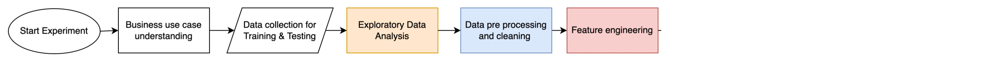

## Feature Engineering
**Missing values analysis & imputation**

As per the problem statement description document, following depicts the missing values for respective attributes

- InsuredGender : Gender - the missing value is represented as “NA”
- PolicyAnnualPremium : Annual Premium – the missing value is represented as “-1”
- TypeOfCollission : Type of Collision - “?” is the missing value
- IncidentTime : time of incident – Hour of the day - the missing value is represented as “-5”
- PropertyDamage : If property damage is there - “?” is the missing value
- Witnesses : Number of witnesses - missing value is represented as "MISSINGVALUE"
- PoliceReport : If police report available - “?” is the missing value
- AmountOfTotalClaim : Total claim amount - the missing value is represented as “MISSEDDATA”
- VehicleAttributeDetails : Value of the vehicle attribute - the missing value is represented as “???”


### InsuredGender missing value represented as 'NA'

In [17]:
#Imputing missing values for InsuredGender with most frequent ones as it turns out to be very few.

from sklearn.impute import SimpleImputer as Imputer
miss_insuredGender = df_train['InsuredGender'].isna().sum()

print("The missing values for InsuredGender are: ", miss_insuredGender)

mode_imputer = Imputer(missing_values= np.nan, strategy='most_frequent')
mode_imputer = mode_imputer.fit(df_train[['InsuredGender']])

df_train['InsuredGender'] = mode_imputer.transform(df_train[['InsuredGender']])
print("Post imputation missing values are: ", df_train['InsuredGender'].isna().sum())

The missing values for InsuredGender are:  30
Post imputation missing values are:  0


### PolicyAnnualPremium missing values represented as "-1"

In [18]:
miss_policy_annual_premium = len(df_train.loc[df_train['PolicyAnnualPremium'] == -1])

print("The missing values for PolicyAnnualPremium are: ", miss_policy_annual_premium)

# Imputing PolicyAnnualPremium with mean value of the column

mean_imputer_prem = Imputer(missing_values=-1, strategy='mean')
mean_imputer_prem = mean_imputer_prem.fit(df_train[['PolicyAnnualPremium']])

df_train['PolicyAnnualPremium'] = mean_imputer_prem.transform(df_train[['PolicyAnnualPremium']])

print("Post imputation missing values are: ", len(df_train.loc[df_train['PolicyAnnualPremium'] == -1]))

The missing values for PolicyAnnualPremium are:  141
Post imputation missing values are:  0


### TypeOfCollission missing values represented as “?” 

In [19]:
miss_type_of_collision = len(df_train.loc[df_train['TypeOfCollission'] == "?"])

print("The missing values for TypeOfCollission are: ", miss_type_of_collision)




The missing values for TypeOfCollission are:  5162


The distribution for TypeOfCollission w.r.t ReportedFraud labels is: 



<AxesSubplot:xlabel='TypeOfCollission', ylabel='count'>

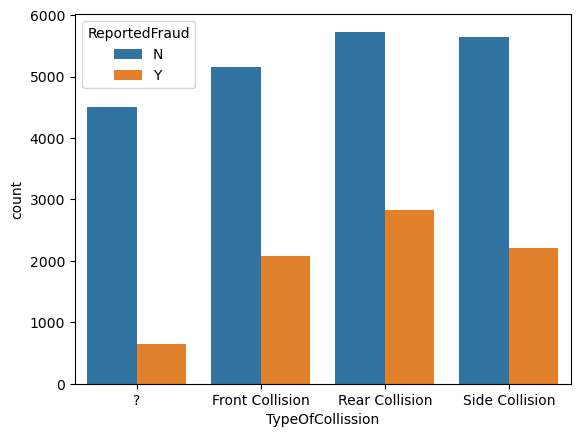

In [20]:
print('\x1b[1;03;30;47m'+"The distribution for TypeOfCollission w.r.t ReportedFraud labels is: \n"+'\x1b[0m')

sns.countplot(x=df_train['TypeOfCollission'], hue=df_train['ReportedFraud'])

**` It seems that all other categories apart from ? are kind of linearly distributed, thus it makes sense to impute ? with similar proportion of categorical values`**

In [21]:
# replacing first '?' with 'NaN'
df_train['TypeOfCollission'] = df_train['TypeOfCollission'].replace('?', np.nan)

# distribution of categories of "TypeOfCollission" values without NaN
print("The disribution of values for TypeOfCollission before imputation and without '?': \n", df_train['TypeOfCollission'].value_counts(normalize=True, dropna=True))

# distribution of categories of "TypeOfCollission" values with NaN
print("The disribution of values for TypeOfCollission before imputation and with '?' \n", df_train['TypeOfCollission'].value_counts(normalize=True, dropna=False))



# imputing the '?' values in proportion to the other categorical values
df_train['TypeOfCollission'] = df_train['TypeOfCollission'].fillna(pd.Series(np.random.choice(['Rear Collision', 'Side Collision', 'Front Collision'], 
                                                                                              p=[0.36,0.33,0.31], size=len(df_train))))

# distribution of categories of "TypeOfCollission" values with NaN
print("The disribution of values for TypeOfCollission after imputation and with '?' \n", df_train['TypeOfCollission'].value_counts(normalize=True, dropna=False))


The disribution of values for TypeOfCollission before imputation and without '?': 
 Rear Collision     0.361620
Side Collision     0.332305
Front Collision    0.306074
Name: TypeOfCollission, dtype: float64
The disribution of values for TypeOfCollission before imputation and with '?' 
 Rear Collision     0.296886
Side Collision     0.272819
Front Collision    0.251283
NaN                0.179012
Name: TypeOfCollission, dtype: float64
The disribution of values for TypeOfCollission after imputation and with '?' 
 Rear Collision     0.359897
Side Collision     0.331565
Front Collision    0.308538
Name: TypeOfCollission, dtype: float64


<AxesSubplot:xlabel='TypeOfCollission', ylabel='count'>

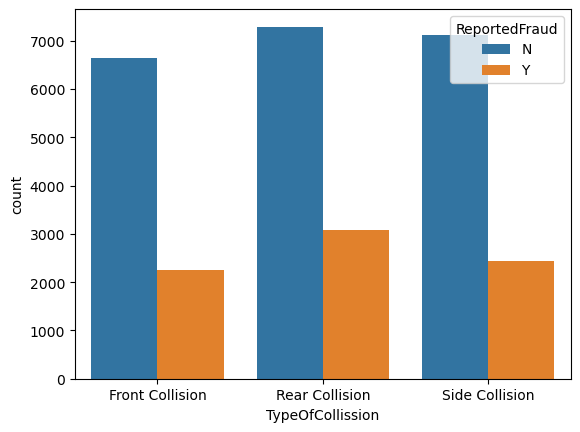

In [22]:
sns.countplot(x=df_train['TypeOfCollission'], hue=df_train['ReportedFraud'])

**`While serving the model, we can impute randomly the missing value for Type of collision`**

### IncidentTime missing value is represented as “-5”

In [23]:
miss_incidentTime=len(df_train.loc[df_train['IncidentTime'] == -5])

print("The missing values for IncidentTime are: ", miss_incidentTime)

# Imputing the missed Incident Time values with most frequent as this represent the hour of the day in 
# which the incidence has been reported

mode_imputer = Imputer(missing_values=-5, strategy='most_frequent')
mode_imputer = mode_imputer.fit(df_train[['IncidentTime']])

df_train['IncidentTime'] = mode_imputer.transform(df_train[['IncidentTime']])

print("Post imputation missing values are: ", len(df_train.loc[df_train['IncidentTime'] == -5]))

The missing values for IncidentTime are:  31
Post imputation missing values are:  0


### PropertyDamage missing value represented as “?”

In [24]:
miss_property_damage = len(df_train.loc[df_train['PropertyDamage'] == "?"])

print("The missing values for PropertyDamage are: ", miss_property_damage)



The missing values for PropertyDamage are:  10459


The distribution for PropertyDamage w.r.t ReportedFraud labels is: 



<AxesSubplot:xlabel='PropertyDamage', ylabel='count'>

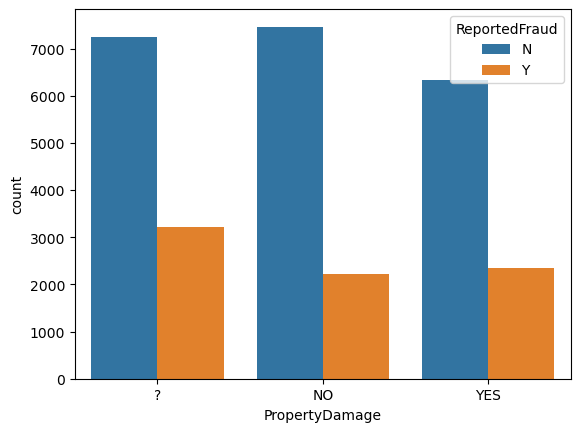

In [25]:
print('\x1b[1;03;30;47m'+"The distribution for PropertyDamage w.r.t ReportedFraud labels is: \n"+'\x1b[0m')

sns.countplot(x=df_train['PropertyDamage'], hue=df_train['ReportedFraud'])

**` It seems, in this case as well all other categories for 'PropertyDamage' apart from ? are kind of linearly distributed, thus it makes sense to impute ? with similar proportion of categorical values`**

In [26]:
# replacing first '?' with 'NaN'

df_train['PropertyDamage'] = df_train['PropertyDamage'].replace('?', np.nan)

# distribution of categories of "PropertyDamage" values after dropping NaN
print("The disribution of values for PropertyDamage before imputation and without '?': \n", df_train['PropertyDamage'].value_counts(normalize=True, dropna=True))

# distribution of categories of "PropertyDamage" values after dropping NaN
print("The disribution of values for PropertyDamage before imputation and with '?': \n", df_train['PropertyDamage'].value_counts(normalize=True, dropna=False))

# imputing the '?' values in proportion to the other categorical values

df_train['PropertyDamage'] = df_train['PropertyDamage'].fillna(pd.Series(np.random.choice(['NO', 'YES'], 
                                                                                              p=[0.53,0.47], size=len(df_train))))


# distribution of categories of "PropertyDamage" values after dropping NaN
print("The disribution of values for PropertyDamage after imputation and with '?': \n", df_train['PropertyDamage'].value_counts(normalize=True, dropna=False))


The disribution of values for PropertyDamage before imputation and without '?': 
 NO     0.527126
YES    0.472874
Name: PropertyDamage, dtype: float64
The disribution of values for PropertyDamage before imputation and with '?': 
 NaN    0.362706
NO     0.335934
YES    0.301359
Name: PropertyDamage, dtype: float64
The disribution of values for PropertyDamage after imputation and with '?': 
 NO     0.531142
YES    0.468858
Name: PropertyDamage, dtype: float64


<AxesSubplot:xlabel='PropertyDamage', ylabel='count'>

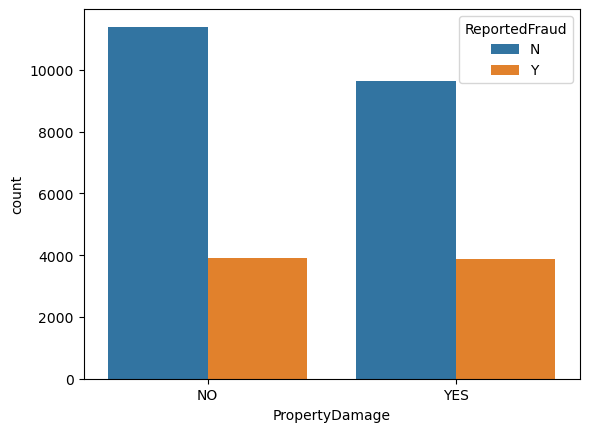

In [27]:
sns.countplot(x=df_train['PropertyDamage'], hue=df_train['ReportedFraud'])

### Witnesses missing value is represented as "MISSINGVALUE"

In [28]:
miss_witness = len(df_train.loc[df_train['Witnesses'] == "MISSINGVALUE"])
print("The missing values for Witnesses are: ", miss_witness)

# Imputing the missed 'Witnesses' values with most frequent as this represent the no. of witnesses for 
# reported Incidence

mode_imputer = Imputer(missing_values="MISSINGVALUE", strategy='most_frequent')
mode_imputer = mode_imputer.fit(df_train[['Witnesses']])

df_train['Witnesses'] = mode_imputer.transform(df_train[['Witnesses']])

print("Post imputation missing values are: ", len(df_train.loc[df_train['Witnesses'] == "MISSINGVALUE"]))

The missing values for Witnesses are:  46
Post imputation missing values are:  0


### PoliceReport missing value reported as "?"

In [29]:
miss_police_report = len(df_train.loc[df_train['PoliceReport'] == "?"])
print("The missing values for PoliceReport are: ", miss_police_report)

The missing values for PoliceReport are:  9805



 The distribution for PoliceReport w.r.t ReportedFraud labels is: 



<AxesSubplot:xlabel='PoliceReport', ylabel='count'>

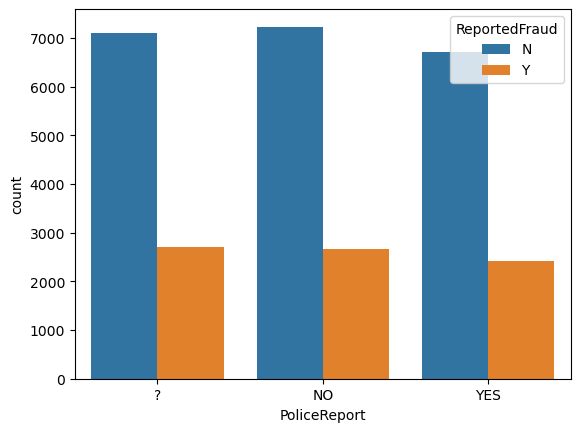

In [30]:
print('\x1b[1;03;30;47m'+"\n The distribution for PoliceReport w.r.t ReportedFraud labels is: \n"+'\x1b[0m')

sns.countplot(x=df_train['PoliceReport'], hue=df_train['ReportedFraud'])

**` It seems that in this case as well all other categories apart from ? are kind of linearly distributed, thus it makes sense to impute ? with similar proportion of categorical values`**

In [31]:
# replacing first '?' with 'NaN'

df_train['PoliceReport'] = df_train['PoliceReport'].replace('?', np.nan)

# distribution of categories of "PoliceReport" values after dropping NaN
print("The disribution of values for PoliceReport before imputation and without '?': \n", df_train['PoliceReport'].value_counts(normalize=True, dropna=True))

# distribution of categories of "PoliceReport" values without dropping NaN
print("The disribution of values for PoliceReport before imputation and with '?': \n", df_train['PoliceReport'].value_counts(normalize=True, dropna=False))

df_train['PoliceReport'] = df_train['PoliceReport'].fillna(pd.Series(np.random.choice(['NO', 'YES'], 
                                                                                              p=[0.52,0.48], size=len(df_train))))

# validating distribution of categories of "PoliceReport" values post imputation
print("The disribution of values for PoliceReport after imputation and with '?': \n", df_train['PoliceReport'].value_counts(normalize=True, dropna=False))


The disribution of values for PoliceReport before imputation and without '?': 
 NO     0.520099
YES    0.479901
Name: PoliceReport, dtype: float64
The disribution of values for PoliceReport before imputation and with '?': 
 NO     0.343251
NaN    0.340026
YES    0.316722
Name: PoliceReport, dtype: float64
The disribution of values for PoliceReport after imputation and with '?': 
 NO     0.521189
YES    0.478811
Name: PoliceReport, dtype: float64


<AxesSubplot:xlabel='PoliceReport', ylabel='count'>

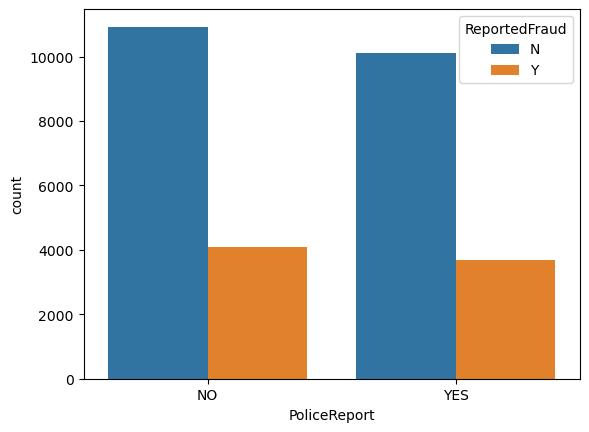

In [32]:
sns.countplot(x=df_train['PoliceReport'], hue=df_train['ReportedFraud'])

### AmountOfTotalClaim missing value is represented as “MISSEDDATA”

In [33]:
miss_amountOfTotalClaim = len(df_train.loc[df_train['AmountOfTotalClaim'] == "MISSEDDATA"])
print("The missing values for AmountOfTotalClaim are: ", miss_amountOfTotalClaim)

# Imputing the missed Amount of total claim values with mean of rest of the values as this represents the amount of 
# money claimed by users

# First converting the MISSEDDATA to NaN
df_train['AmountOfTotalClaim'] = df_train['AmountOfTotalClaim'].replace('MISSEDDATA', np.nan)

# Changing dtype of the feature column to float from object
df_train['AmountOfTotalClaim'] = df_train['AmountOfTotalClaim'].astype('float')

# Imputing mean 

mean_imputer_prem = Imputer(missing_values=np.nan, strategy='mean')
mean_imputer_prem = mean_imputer_prem.fit(df_train[['AmountOfTotalClaim']])

df_train['AmountOfTotalClaim'] = mean_imputer_prem.transform(df_train[['AmountOfTotalClaim']])

print("Post imputation missing values are: ", len(df_train.loc[df_train['AmountOfTotalClaim'] == "MISSEDDATA"]))


The missing values for AmountOfTotalClaim are:  50
Post imputation missing values are:  0


### VehicleAttributeDetails missing value is represented as “???”

Since VehicleAttributeDetails have been converted in to three different columns during Data Preprocessing step, this imputation shall be carried out for all the three respective feature columns

In [34]:
miss_vehicle_model=len(df_train.loc[(df_train['VehicleModel'] == "???")])
miss_vehicle_make=len(df_train.loc[(df_train['VehicleMake'] == "???")])
miss_vehicle_yom=len(df_train.loc[(df_train['VehicleYOM'] == "???")])

print("The missing values for VehicleModel, VehicleMake & VehicleYOM are: ", miss_vehicle_model, miss_vehicle_make, miss_vehicle_yom)

The missing values for VehicleModel, VehicleMake & VehicleYOM are:  0 50 0


**`Missing values are only for VehicleMake`**

Imputing the missed values with most frequent ones.

In [35]:
mode_imputer = Imputer(missing_values="???", strategy='most_frequent')
mode_imputer = mode_imputer.fit(df_train[['VehicleMake']])

df_train['VehicleMake'] = mode_imputer.transform(df_train[['VehicleMake']])

print("Post imputation missing values are: ", len(df_train.loc[df_train['VehicleMake'] == "???"]))

Post imputation missing values are:  0


In [36]:
# Validating the post imputation results
df_train.isna().sum()

ReportedFraud                 0
DateOfIncident                0
TypeOfIncident                0
TypeOfCollission              0
SeverityOfIncident            0
AuthoritiesContacted          0
IncidentState                 0
IncidentCity                  0
IncidentAddress               0
IncidentTime                  0
NumberOfVehicles              0
PropertyDamage                0
BodilyInjuries                0
Witnesses                     0
PoliceReport                  0
AmountOfTotalClaim            0
AmountOfInjuryClaim           0
AmountOfPropertyClaim         0
AmountOfVehicleDamage         0
InsuredAge                    0
InsuredZipCode                0
InsuredGender                 0
InsuredEducationLevel         0
InsuredOccupation             0
InsuredHobbies                0
CapitalGains                  0
CapitalLoss                   0
CustomerLoyaltyPeriod         0
DateOfPolicyCoverage          0
InsurancePolicyState          0
Policy_CombinedSingleLimit    0
Policy_D

**`Summarizing the imputations carried out`**

In [37]:
print("Summary of missing value imputations that were imputed is as follows: \n")
print('\x1b[1;03;30;47m'+'For InsuredGender:'+'\x1b[0m', miss_insuredGender)
print('\x1b[1;03;30;47m'+'For PolicyAnnualPremium:'+'\x1b[0m', miss_policy_annual_premium)
print('\x1b[1;03;30;47m'+'For TypeOfCollission:'+'\x1b[0m', miss_type_of_collision)
print('\x1b[1;03;30;47m'+'For IncidentTime:'+'\x1b[0m', miss_incidentTime)
print('\x1b[1;03;30;47m'+'For PropertyDamage:'+'\x1b[0m', miss_property_damage)
print('\x1b[1;03;30;47m'+'For Witnesses:'+'\x1b[0m', miss_witness)
print('\x1b[1;03;30;47m'+'For PoliceReport:'+'\x1b[0m', miss_police_report)
print('\x1b[1;03;30;47m'+'For AmountOfTotalClaim:'+'\x1b[0m', miss_amountOfTotalClaim)
print('\x1b[1;03;30;47m'+'For VehicleModel:'+'\x1b[0m', miss_vehicle_model)
print('\x1b[1;03;30;47m'+'For VehicleMake:'+'\x1b[0m', miss_vehicle_make)
print('\x1b[1;03;30;47m'+'For VehicleYOM:'+'\x1b[0m', miss_vehicle_yom)


Summary of missing value imputations that were imputed is as follows: 

For InsuredGender: 30
For PolicyAnnualPremium: 141
For TypeOfCollission: 5162
For IncidentTime: 31
For PropertyDamage: 10459
For Witnesses: 46
For PoliceReport: 9805
For AmountOfTotalClaim: 50
For VehicleModel: 0
For VehicleMake: 50
For VehicleYOM: 0


### Train Test split

In [38]:
X = df_train.drop(['ReportedFraud'],axis=1)
y = df_train['ReportedFraud']

In [39]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.30,random_state = 100)

In [40]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(20185, 37)
(8651, 37)
(20185,)
(8651,)


In [41]:
y_train.value_counts(normalize=True)*100

N    73.059202
Y    26.940798
Name: ReportedFraud, dtype: float64

In [42]:
y_test.value_counts(normalize=True)*100

N    72.870188
Y    27.129812
Name: ReportedFraud, dtype: float64

In [43]:
cat_cols = ['TypeOfIncident', 'SeverityOfIncident', 'AuthoritiesContacted', 'IncidentState', 'IncidentCity', 
            'Witnesses', 'InsuredGender', 'InsuredEducationLevel',
            'InsuredOccupation', 'InsuredHobbies', 'InsurancePolicyState', 'Policy_CombinedSingleLimit',
            'InsuredRelationship',
            'VehicleModel','VehicleMake']

num_cols = ['DateOfIncident', 'IncidentTime', 'NumberOfVehicles', 'BodilyInjuries', 'IncidentAddress',
            'AmountOfInjuryClaim', 'AmountOfPropertyClaim', 'AmountOfVehicleDamage', 'InsuredAge', 'AmountOfTotalClaim',
            'InsuredZipCode','CapitalGains', 'CapitalLoss', 'CustomerLoyaltyPeriod',
            'DateOfPolicyCoverage','Policy_Deductible', 'PolicyAnnualPremium', 'UmbrellaLimit','VehicleYOM']

for col in [cat_cols]:
    df_train[col] = df_train[col].astype('category')



In [44]:
df_train_cat = df_train[cat_cols]
df_train_num = df_train[num_cols]

In [45]:
df_train_cat.dtypes

TypeOfIncident                category
SeverityOfIncident            category
AuthoritiesContacted          category
IncidentState                 category
IncidentCity                  category
Witnesses                     category
InsuredGender                 category
InsuredEducationLevel         category
InsuredOccupation             category
InsuredHobbies                category
InsurancePolicyState          category
Policy_CombinedSingleLimit    category
InsuredRelationship           category
VehicleModel                  category
VehicleMake                   category
dtype: object

In [46]:
df_train_num.dtypes

DateOfIncident              int64
IncidentTime                int64
NumberOfVehicles         category
BodilyInjuries           category
IncidentAddress            object
AmountOfInjuryClaim         int64
AmountOfPropertyClaim       int64
AmountOfVehicleDamage       int64
InsuredAge                  int64
AmountOfTotalClaim        float64
InsuredZipCode              int64
CapitalGains                int64
CapitalLoss                 int64
CustomerLoyaltyPeriod       int64
DateOfPolicyCoverage        int64
Policy_Deductible           int64
PolicyAnnualPremium       float64
UmbrellaLimit               int64
VehicleYOM               category
dtype: object

In [47]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df_train_num, title="Feature analysis using pandas profiling")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [48]:
for col in ['NumberOfVehicles', 'BodilyInjuries']:
    df_train_num[col] = df_train_num[col].astype('int64')
    


/var/folders/t_/lrpykrwd2z51b0hwdttpyf7c0000gn/T/ipykernel_88294/1950680646.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train_num[col] = df_train_num[col].astype('int64')


In [49]:
df_train_num.dtypes

DateOfIncident              int64
IncidentTime                int64
NumberOfVehicles            int64
BodilyInjuries              int64
IncidentAddress            object
AmountOfInjuryClaim         int64
AmountOfPropertyClaim       int64
AmountOfVehicleDamage       int64
InsuredAge                  int64
AmountOfTotalClaim        float64
InsuredZipCode              int64
CapitalGains                int64
CapitalLoss                 int64
CustomerLoyaltyPeriod       int64
DateOfPolicyCoverage        int64
Policy_Deductible           int64
PolicyAnnualPremium       float64
UmbrellaLimit               int64
VehicleYOM               category
dtype: object

In [50]:
# train test data frames for numerical columns
df_num_train = X_train[num_cols]
df_num_test = X_test[num_cols]

# train test data frames for categorical columns
df_cat_train = X_train[cat_cols]
df_cat_test = X_test[cat_cols]

### Feature transformation
**One hot encoding for categorical features**

In [51]:
from sklearn.preprocessing import OneHotEncoder
ohe = OneHotEncoder(handle_unknown='ignore')
ohe.fit(df_cat_train)

df_cat_train_ohe = ohe.transform(df_cat_train).toarray()
df_cat_test_ohe = ohe.transform(df_cat_test).toarray()

print(df_cat_train_ohe.shape)
print(df_cat_test_ohe.shape)

(20185, 145)
(8651, 145)


**Normalizing numerical features**

In [52]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(df_num_train)

df_num_imp_train = scaler.transform(df_num_train)
df_num_imp_test = scaler.transform(df_num_test)

**Finally concatenating all the feature columns**

In [53]:
X_train_con = np.concatenate([df_cat_train_ohe, df_num_imp_train], axis=1)
X_test_con = np.concatenate([df_cat_test_ohe, df_num_imp_test], axis=1)
print(X_train_con.shape)
print(X_test_con.shape)

(20185, 164)
(8651, 164)


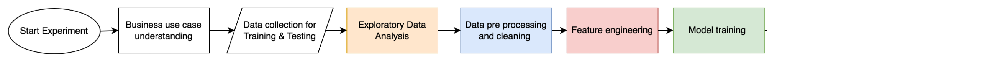

### Model training

**In this section we shall try and train multiple type of supervised classifiers and then select the best of all during testing and evaluation**

In [54]:
# Logistic Regression

from sklearn.linear_model import LogisticRegression
lr = LogisticRegression()
lr.fit(X_train_con,y_train)

# Saving the training and test predictions
lr_train_preds = lr.predict(X_train_con)
lr_test_preds = lr.predict(X_test_con)

/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [55]:
# Random forest classifier

from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier()
rfc.fit(X_train_con,y_train)

# Saving the training and test predictions
rfc_train_preds = rfc.predict(X_train_con)
rfc_test_preds = rfc.predict(X_test_con)

In [56]:
# SVM classifier

from sklearn.svm import SVC
svc = SVC(kernel = 'rbf')
svc.fit(X_train_con,y_train)

# Saving the training and test predictions
svc_train_preds = svc.predict(X_train_con)
svc_test_preds = svc.predict(X_test_con)

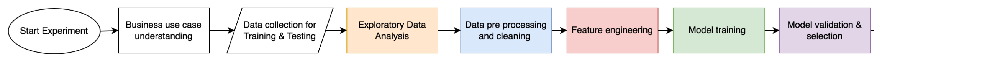

## Model evaluation & selection

**First on training data set**

In [57]:
from sklearn.metrics import confusion_matrix
cf_train_lr_matrix = confusion_matrix(y_train, lr_train_preds)
cf_train_rfc_matrix = confusion_matrix(y_train, rfc_train_preds)
cf_train_svc_matrix = confusion_matrix(y_train, svc_train_preds)


**Second on test data set**

In [58]:
from sklearn.metrics import confusion_matrix
cf_test_lr_matrix = confusion_matrix(y_test, lr_test_preds)
cf_test_rfc_matrix = confusion_matrix(y_test, rfc_test_preds)
cf_test_svc_matrix = confusion_matrix(y_test, svc_test_preds)


In [59]:
def make_confusion_matrix(cf,
                          group_names=None,
                          categories='auto',
                          count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label' + stats_text)
        plt.xlabel('Predicted label') #+ stats_text)
    else:
        plt.ylabel(stats_text)
        #plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

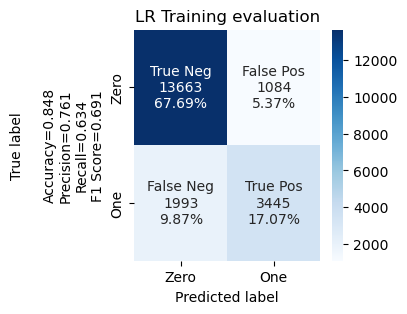

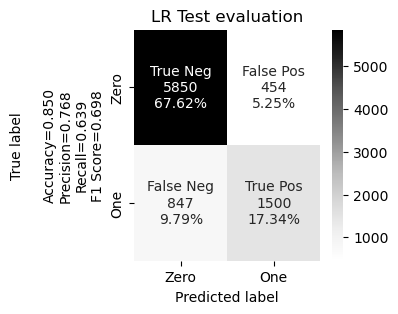

In [60]:
# Train and Test evaluation for Linear Regression

labels = ['True Neg','False Pos','False Neg','True Pos']
categories = ['Zero', 'One']
make_confusion_matrix(cf_train_lr_matrix, 
                      group_names=labels,
                      categories=categories, 
                      cmap='Blues',
                      title='LR Training evaluation',
                      figsize=(3,3))

make_confusion_matrix(cf_test_lr_matrix, 
                      group_names=labels,
                      categories=categories, 
                      cmap='Greys',
                      title='LR Test evaluation',
                      figsize=(3,3))


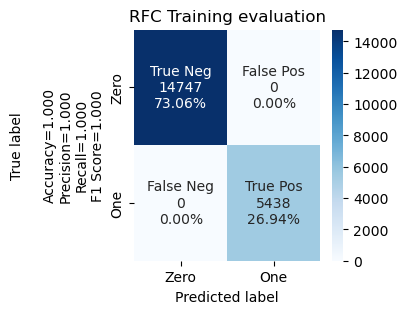

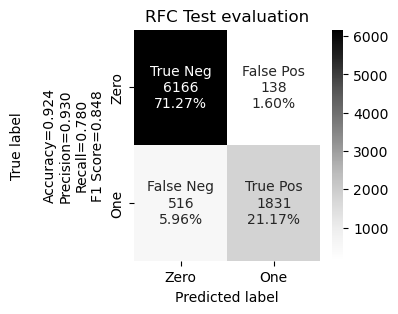

In [61]:
# Train and Test evaluation for RFC

labels = ['True Neg','False Pos','False Neg','True Pos']
categories = ['Zero', 'One']
make_confusion_matrix(cf_train_rfc_matrix, 
                      group_names=labels,
                      categories=categories, 
                      cmap='Blues',
                      title='RFC Training evaluation',
                      figsize=(3,3))

make_confusion_matrix(cf_test_rfc_matrix, 
                      group_names=labels,
                      categories=categories, 
                      cmap='Greys',
                      title='RFC Test evaluation',
                      figsize=(3,3))

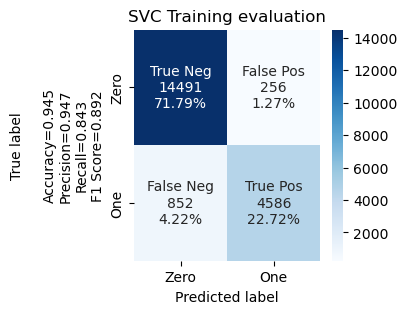

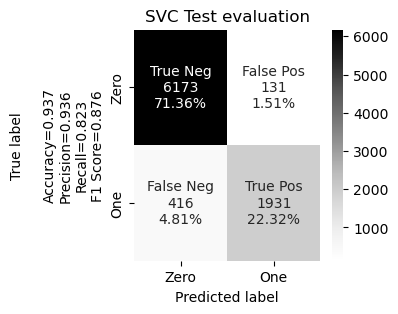

In [62]:
# Train and Test evaluation for SVC

labels = ['True Neg','False Pos','False Neg','True Pos']
categories = ['Zero', 'One']
make_confusion_matrix(cf_train_svc_matrix, 
                      group_names=labels,
                      categories=categories, 
                      cmap='Blues',
                      title='SVC Training evaluation',
                      figsize=(3,3))

make_confusion_matrix(cf_test_svc_matrix, 
                      group_names=labels,
                      categories=categories, 
                      cmap='Greys',
                      title='SVC Test evaluation',
                      figsize=(3,3))



**`Based on above validation and evaluation results, it can be inferred that SVC seems to perform the best on both training as well as test data and hence shall be a good candidate for deployment`**

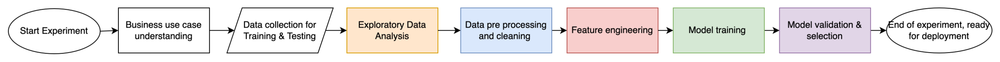

## Finalizing the experiment and serializing the model for deployment

In [63]:
# Serializing the model using pickle

filename = 'UC1_svc_model.sav'
pickle.dump(svc, open(filename, 'wb'))

<IPython.core.display.Javascript object>

In [64]:
# Loading back and testing the serialized model 

loaded_model = pickle.load(open(filename, 'rb'))
result = loaded_model.score(X_test_con, y_test)
print(result)

<IPython.core.display.Javascript object>

0.9367703155704543


## Finding the top 20 patterns 

In [65]:
train_x = pd.get_dummies(X_train[cat_cols])

# Training Decision Tree Classifier to identify top 20 patterns

from sklearn.tree import DecisionTreeClassifier

clf_n = DecisionTreeClassifier(max_leaf_nodes=20, random_state=0)

clf_n.fit(train_x, y_train)

DecisionTreeClassifier(max_leaf_nodes=20, random_state=0)

In [66]:
estimator = clf_n

from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, 
                out_file='tree_n.dot', 
                feature_names = train_x.columns,
                class_names = y.unique(),
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png
from subprocess import call
call(['dot', '-Tpng', 'tree_n.dot', '-o', 'tree_n.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree_n.png')